In [1]:
from sympy import init_printing; init_printing();
from sympy import symbols, sin, cos, tan, acos, sqrt, Eq, Function, Array
from einsteinpy.symbolic import MetricTensor, ChristoffelSymbols, RiemannCurvatureTensor

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # display all expression in one cell instead of the last one

## Cartesian Coordinates

Simply $(x, y, z)$.

## Cylindrical Coordinates

Transform Relation from $(r, \theta, \phi)$ to $(x, y, z)$:

\begin{equation}
\left\{\begin{matrix}
x =& R &\sin\phi \\ 
y =& R &\sin\phi \\ 
z =& Z &
\end{matrix}\right.
\end{equation}

Transform Relation from $(x, y, z)$ to $(r, \theta, \phi)$:
\begin{equation}
\left\{\begin{matrix}
 & R^2 =& x^2+y^2 & \\ 
 & Z =& z & \\ 
\tan & \phi  =& y/x & 
\end{matrix}\right.
\end{equation}

Many programming languages have `atan2(y, x)` to avoid the function `atan(y/x)` which is not smart enough.

/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: Matpl

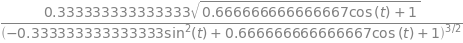

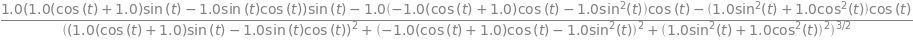

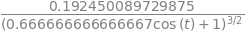

In [2]:
from silkpy.curve import ParametricCurve, draw_curve_plotly
t, u, v = symbols('t, u, v', real=True)
a, b = 1.0, 1.0
cylind_curve = ParametricCurve([a*cos(t), a*sin(t), b*t + sin(t)], t)
cylind_curve.curvature().simplify()
cylind_curve.torsion()
cylind_curve.torsion().simplify()
# cylind_curve.expr().shape !=(3, )

In [42]:
from silkpy.surface import ParametricSurface, draw_surface_plotly
wave_surface = ParametricSurface([u, v, sin(u)**2 + sin(v)**2], [u,v])
wave_surface.expr()

# draw_curve_plotly(cylind_curve, domain=(-6, 6), num=200)
# draw_curve_plotly(cylind_curve, domain=(-6, 6), num=200, color_func=(lambda curve: curve.torsion().simplify()))
draw_surface_plotly(wave_surface, domain=[(-10, 30), (-10, 30)], num=[300, 300])

⎡         2         2   ⎤
⎣u  v  sin (u) + sin (v)⎦

In [44]:
from sympy import pi
a, b, d = 1.32, 1., 0.8
c = a**2 - b**2
dupin_surface = ParametricSurface([
    (d * (c - a * cos(u) * cos(v)) + b**2 * cos(u)) / (a - c * cos(u) * cos(v)), 
    b * sin(u) * (a - d*cos(v)) / (a - c * cos(u) * cos(v)), 
    b * sin(v) * (c*cos(u) - d) / (a - c * cos(u) * cos(v))], [u,v])
draw_surface_plotly(dupin_surface, domain=[(0, 2*pi), (0, 2*pi)], num=[300, 300])

[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.021014   0.021014   0.021014   ... 0.021014   0.021014   0.021014  ]
 [0.042028   0.042028   0.042028   ... 0.042028   0.042028   0.042028  ]
 ...
 [6.24115731 6.24115731 6.24115731 ... 6.24115731 6.24115731 6.24115731]
 [6.26217131 6.26217131 6.26217131 ... 6.26217131 6.26217131 6.26217131]
 [6.28318531 6.28318531 6.28318531 ... 6.28318531 6.28318531 6.28318531]]


In [ ]:
InteractiveShell.ast_node_interactivity = "last" 

In [9]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Equation of ring cyclide
# see https://en.wikipedia.org/wiki/Dupin_cyclide
import numpy as np

u, v = np.mgrid[0:2*np.pi:100j, 0:2*np.pi:100j]
x = (d * (c - a * np.cos(u) * np.cos(v)) + b**2 * np.cos(u)) / (a - c * np.cos(u) * np.cos(v))
y = b * np.sin(u) * (a - d*np.cos(v)) / (a - c * np.cos(u) * np.cos(v))
z = b * np.sin(v) * (c*np.cos(u) - d) / (a - c * np.cos(u) * np.cos(v))

fig = make_subplots(rows=1, cols=2,
                    specs=[[{'is_3d': True}, {'is_3d': True}]],
                    subplot_titles=['Color corresponds to z', 'Color corresponds to distance to origin'],
                    )

fig.add_trace(go.Surface(x=x, y=y, z=z, colorbar_x=-0.07), 1, 1)
fig.add_trace(go.Surface(x=x, y=y, z=z, surfacecolor=x**2 + y**2 + z**2), 1, 2)
fig.update_layout(title_text="Ring cyclide")
fig.show()

In [ ]:
from einsteinpy.symbolic.vector import GenericVector
# define the metric for 3d spherical coordinates
metric = [[1 if i==j else 0 for j in range(3)] for i in range(3)]
m_obj = MetricTensor(metric, (a*cos(t), a*sin(t), b*t), config='ll')
m_obj.tensor()
GenericVector([a*cos(t), a*sin(t), b*t], [a*cos(t), a*sin(t), b*t], parent_metric=m_obj)

In [21]:
from sympy.solvers.inequalities import solve_univariate_inequality
from sympy import Interval, oo
xx = symbols('xx')
domain = solve_univariate_inequality( 5> x**2 >= 4, x, relational=False, continuous=True)
domain.args[0]

In [27]:
from sympy import lambdify, Array
import numpy as np
num = 50
domain_ = np.linspace(0, 5, num=num)
values_ = lambdify(t, Array([t, t**2,t**3]), 'numpy')(domain_)
values_

[array([0.        , 0.10204082, 0.20408163, 0.30612245, 0.40816327,
        0.51020408, 0.6122449 , 0.71428571, 0.81632653, 0.91836735,
        1.02040816, 1.12244898, 1.2244898 , 1.32653061, 1.42857143,
        1.53061224, 1.63265306, 1.73469388, 1.83673469, 1.93877551,
        2.04081633, 2.14285714, 2.24489796, 2.34693878, 2.44897959,
        2.55102041, 2.65306122, 2.75510204, 2.85714286, 2.95918367,
        3.06122449, 3.16326531, 3.26530612, 3.36734694, 3.46938776,
        3.57142857, 3.67346939, 3.7755102 , 3.87755102, 3.97959184,
        4.08163265, 4.18367347, 4.28571429, 4.3877551 , 4.48979592,
        4.59183673, 4.69387755, 4.79591837, 4.89795918, 5.        ]),
 array([0.00000000e+00, 1.04123282e-02, 4.16493128e-02, 9.37109538e-02,
        1.66597251e-01, 2.60308205e-01, 3.74843815e-01, 5.10204082e-01,
        6.66389005e-01, 8.43398584e-01, 1.04123282e+00, 1.25989171e+00,
        1.49937526e+00, 1.75968347e+00, 2.04081633e+00, 2.34277384e+00,
        2.66555602e+00, 3.0091

In [28]:
import plotly.graph_objects as go
fig = go.Figure()

In [2]:
R = symbols('R', positive=True); Z, phi = symbols('Z phi', real=True)
x, y, z = [f(R, Z, phi) for f in symbols('x, y, z', real=True, cls=Function)]

In [3]:
eq_list = [
    Eq(x, R * cos(phi)),
    Eq(y, R * sin(phi)),
    Eq(z, Z)]
for eq in eq_list: eq
diffed_eq_list = []
for eq in eq_list:
    for var in [R, Z, phi]:
        diffed_eq_list.append(
            Eq(eq.lhs.diff(var),
               eq.rhs.diff(var)))# .subs(x**2+y**2+z**2, r**2).simplify() )

/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/IPython/lib/latextools.py:126: Matpl

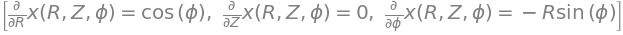

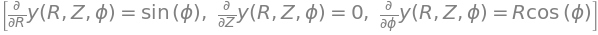

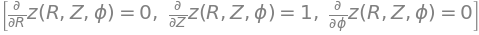

In [4]:
[eq for eq in diffed_eq_list[0:3]]
[eq for eq in diffed_eq_list[3:6]]
[eq for eq in diffed_eq_list[6:9]]

\begin{equation}
\vec{r}_{1} = \frac{\partial \vec{r}}{\partial R} = \frac{\partial (x\hat{x}+y\hat{y}+z\hat{z})}{\partial R},\quad
\vec{r}_{2} = \frac{\partial \vec{r}}{\partial Z} = \frac{\partial (x\hat{x}+y\hat{y}+z\hat{z})}{\partial Z},\quad
\vec{r}_{3} = \frac{\partial \vec{r}}{\partial \phi} = \frac{\partial (x\hat{x}+y\hat{y}+z\hat{z})}{\partial \phi}
\end{equation}

In [5]:
r_i = [None, None, None] # The three components would be 
for i, var in enumerate([R, Z, phi]):
    r_i_temp = Array([x.diff(var), y.diff(var), z.diff(var)])
    for eq in diffed_eq_list:
        r_i_temp = r_i_temp.subs(eq.lhs, eq.rhs)
    r_i[i] = r_i_temp; r_i[i]
    

[cos(φ)  sin(φ)  0]

[0  0  1]

[-R⋅sin(φ)  R⋅cos(φ)  0]

In [6]:
from sympy import trigsimp
# define the metric for 3d cylindrical coordinates
metric = [[0 for i in range(3)] for i in range(3)]
for i in range(3):
    for j in range(3):
        metric[i][j] = (lambda vec1, vec2: 
                        vec1[0]*vec2[0] + vec1[1]*vec2[1] + vec1[2]*vec2[2])(r_i[i], r_i[j])
        metric[i][j] = trigsimp(metric[i][j])
        # metric[i][j]
# creating metric object
m_obj = MetricTensor(metric, (R, Z, phi), config='ll'); m_obj.tensor()
g = m_obj.tensor().tomatrix().det(); g

⎡1  0  0 ⎤
⎢        ⎥
⎢0  1  0 ⎥
⎢        ⎥
⎢       2⎥
⎣0  0  R ⎦

In [7]:
ch = ChristoffelSymbols.from_metric(m_obj)
ch.config

'ull'

In [8]:
# Calculating Riemann Tensor from Christoffel Symbols
rm1 = RiemannCurvatureTensor.from_christoffels(ch)
rm1.tensor()

⎡⎡0  0  0⎤  ⎡0  0  0⎤  ⎡0  0  0⎤⎤
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎢0  0  0⎥  ⎢0  0  0⎥  ⎢0  0  0⎥⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎣0  0  0⎦  ⎣0  0  0⎦  ⎣0  0  0⎦⎥
⎢                               ⎥
⎢⎡0  0  0⎤  ⎡0  0  0⎤  ⎡0  0  0⎤⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎢0  0  0⎥  ⎢0  0  0⎥  ⎢0  0  0⎥⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎣0  0  0⎦  ⎣0  0  0⎦  ⎣0  0  0⎦⎥
⎢                               ⎥
⎢⎡0  0  0⎤  ⎡0  0  0⎤  ⎡0  0  0⎤⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎢0  0  0⎥  ⎢0  0  0⎥  ⎢0  0  0⎥⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎣⎣0  0  0⎦  ⎣0  0  0⎦  ⎣0  0  0⎦⎦

In [9]:
# Calculating Riemann Tensor from Metric Tensor
rm2 = RiemannCurvatureTensor.from_metric(m_obj)
rm2.tensor()

⎡⎡0  0  0⎤  ⎡0  0  0⎤  ⎡0  0  0⎤⎤
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎢0  0  0⎥  ⎢0  0  0⎥  ⎢0  0  0⎥⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎣0  0  0⎦  ⎣0  0  0⎦  ⎣0  0  0⎦⎥
⎢                               ⎥
⎢⎡0  0  0⎤  ⎡0  0  0⎤  ⎡0  0  0⎤⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎢0  0  0⎥  ⎢0  0  0⎥  ⎢0  0  0⎥⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎣0  0  0⎦  ⎣0  0  0⎦  ⎣0  0  0⎦⎥
⎢                               ⎥
⎢⎡0  0  0⎤  ⎡0  0  0⎤  ⎡0  0  0⎤⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎢⎢0  0  0⎥  ⎢0  0  0⎥  ⎢0  0  0⎥⎥
⎢⎢       ⎥  ⎢       ⎥  ⎢       ⎥⎥
⎣⎣0  0  0⎦  ⎣0  0  0⎦  ⎣0  0  0⎦⎦

## Construct $\rho$ and $\vec{J}$ Field

In [10]:
from sympy import exp, Matrix, sqrt, trigsimp
from einsteinpy.symbolic.tensor import BaseRelativityTensor
from einsteinpy.symbolic.vector import GenericVector


In [11]:
# define the Levi-Civita tensor for 3d cylindrical coordinates
levi_civita_arr_lll = [[[0 for k in range(3)] for j in range(3)] for i in range(3)]
for i in range(3):
    for j in range(3):
        for k in range(3):
            levi_civita_arr_lll[i][j][k] = Matrix([r_i[i], r_i[j], r_i[k]]).det() / sqrt(g)
            levi_civita_arr_lll[i][j][k] = trigsimp(levi_civita_arr_lll[i][j][k])

In [12]:
levi_civita = BaseRelativityTensor(
    levi_civita_arr_lll,
    (R,Z,phi), config='lll', parent_metric=m_obj)
levi_civita.tensor()

⎡⎡0  0  0 ⎤  ⎡0   0  1⎤  ⎡0  -1  0⎤⎤
⎢⎢        ⎥  ⎢        ⎥  ⎢        ⎥⎥
⎢⎢0  0  -1⎥  ⎢0   0  0⎥  ⎢1  0   0⎥⎥
⎢⎢        ⎥  ⎢        ⎥  ⎢        ⎥⎥
⎣⎣0  1  0 ⎦  ⎣-1  0  0⎦  ⎣0  0   0⎦⎦

In [13]:
density_df = BaseRelativityTensor(
    arr=exp(-R**2),
    syms=(R,Z,phi), config='', parent_metric=m_obj); density_df.arr

sqrt_g_df = BaseRelativityTensor(
    arr=sqrt(g),
    syms=(R,Z,phi), config='', parent_metric=m_obj); sqrt_g_df.arr

nabla_density_df = GenericVector(
    arr=[exp(-R**2).diff(var) for var in [R,Z,phi]],
    syms=(R,Z,phi), config='l', parent_metric=m_obj)
nabla_density_df

B_comp_list = [f(R,Z,phi) for f in symbols("B^1:4", real=True, cls=Function)]
B_df = GenericVector(
    arr=B_comp_list,
    syms=(R,Z,phi), config='u', parent_metric=m_obj)
B_df.tensor()

GenericVector[-2*R*exp(-R**2), 0, 0]

[B¹(R, Z, φ)  B²(R, Z, φ)  B³(R, Z, φ)]

In [14]:
J_df = GenericVector([0, exp(-R**2), exp(-R**2)], (R,Z,phi), config='u', parent_metric=m_obj)
J_df
# j_df = j_df.change_config('l')
J2_df = GenericVector([0,exp(-R**2),0], (R,Z,phi), config='u', parent_metric=m_obj)

GenericVector[0, exp(-R**2), exp(-R**2)]

In [15]:
J_df == J2_df
J_df.tensor() == j2_df.tensor()

False

False

In [16]:
from einsteinpy.symbolic.tensor import tensor_product
tensor_product(density_df, J_df)

BaseRelativityTensor[0, exp(-2*R**2), exp(-2*R**2)]

In [17]:
def tensor_cross(tensor1, tensor2, i=None, j=None):
    from einsteinpy.symbolic.tensor import tensor_product as prod
    middle_tensor = \
        prod( 
            prod(
                prod(levi_civita, sqrt_g_df), 
                tensor1, i=0,j=0
                ), 
            tensor2, i=0,j=0 
            )
#     middle_tensor.change_config('llluu')
    return middle_tensor

In [18]:
# nabla_density == j x B
nabla_density_df.tensor(), nabla_density_df.config
tensor_cross(J_df, B_df).tensor() # j x B
tensor_cross(J_df, B_df).config

([-2*R*exp(-R**2), 0, 0], 'l')

⎡                                 2                    2                   2⎤
⎢                               -R                   -R                  -R ⎥
⎣R⋅(B²(R, Z, φ) - B³(R, Z, φ))⋅ℯ     -R⋅B¹(R, Z, φ)⋅ℯ     R⋅B¹(R, Z, φ)⋅ℯ   ⎦

'l'

In [19]:
ideal_MHD_eq = Eq(
    nabla_density_df.tensor(), 
    tensor_cross(J_df, B_df).tensor())

In [20]:
def divide_Array_Eq(eq):
    from sympy import Eq
    assert(eq.lhs.shape == eq.rhs.shape)
    eq_shape = eq.lhs.shape
    arr_order = len(eq_shape) 
    if arr_order > 1: # Not yet tested for high order tensor
        eq_list = []
        for i in range(eq_shape[0]):
            eq_list.append(
                divide_Array_Eq(Eq(eq.lhs[i], eq.rhs[i]))
            )
        return eq_list
    elif arr_order == 1:
        return [Eq(eq.lhs[i], eq.rhs[i]) for i in range(eq_shape[0])]
    else:# arr_order == 0
        return eq

In [21]:
from sympy import solve, nonlinsolve
B_sol = solve(
    divide_Array_Eq(ideal_MHD_eq), 
    B_df.tensor().tolist())
B_sol

In [22]:
B_comp_list
B_comp_N_list = B_comp_list
for i in range(len(B_comp_N_list)):
    B_comp_N_list[i] = B_comp_N_list[i].subs(B_sol)
    B_comp_N_list[i] = B_comp_N_list[i].subs({B_comp_list[1]: 4, B_comp_list[2]: 6})
B_comp_N_list



B_N_df = GenericVector(
    arr=B_comp_N_list,
    syms=(R,Z,phi), config='u', parent_metric=m_obj)
B_N_df.tensor()

[0  4  6]

In [23]:
from scipy.integrate import ode as scipy_ode
import ray; ray.init()

/home/wenyin/pyvenv/vsym/lib/python3.7/site-packages/ray/autoscaler/_private/cli_logger.py:61: FutureWarning: Not all Ray CLI dependencies were found. In Ray 1.4+, the Ray CLI, autoscaler, and dashboard will only be usable via `pip install 'ray[default]'`. Please update your install command.
  "update your install command.", FutureWarning)
2021-05-20 19:01:52,163	INFO services.py:1269 -- View the Ray dashboard at http://127.0.0.1:8265


{'node_ip_address': '114.214.245.114',
 'raylet_ip_address': '114.214.245.114',
 'redis_address': '114.214.245.114:6379',
 'object_store_address': '/tmp/ray/session_2021-05-20_19-01-50_456657_20581/sockets/plasma_store',
 'raylet_socket_name': '/tmp/ray/session_2021-05-20_19-01-50_456657_20581/sockets/raylet',
 'webui_url': '127.0.0.1:8265',
 'session_dir': '/tmp/ray/session_2021-05-20_19-01-50_456657_20581',
 'metrics_export_port': 50990,
 'node_id': '04f5a902cb3dba50ec6e68660117ec4a3ba795eacbcbff46717101c7'}

In [29]:
from scipy.integrate import ode as _scipy_ode

# @ray.remote
class FieldTracer(_scipy_ode): # FieldTracer is a kind of ode integrator. 
    def __init__(self, vec_field):
        from sympy.utilities.lambdify import lambdify
        assert(vec_field.config == 'u')
        A__1, A__2, A__3 = vec_field.tensor().tolist()
        A__1 = lambdify(vec_field.syms, A__1)
        A__2 = lambdify(vec_field.syms, A__2)
        A__3 = lambdify(vec_field.syms, A__3)
        def dfdt(t, x):
            du1 = A__1(*x)
            du2 = A__2(*x)
            du3 = A__3(*x)
            return [du1, du2, du3]
        _scipy_ode.__init__(self, dfdt)
        
    def integrate_until(self, t1, dt):
        import numpy as np
        num_of_t = int(t1 / dt); num_of_t
        u_arr = np.empty((num_of_t, 3)); u_arr[0, :] = self._y
        t_arr = np.arange(num_of_t) * dt
        i = 0
        while self.successful() and i < num_of_t-1:
            i += 1
            u_arr[i, :] = self.integrate(self.t+dt)
        return u_arr, t_arr
    
    def set_f_params(self, *args, **kwargs):
        raise DeprecationWarning("The set_f_params method has been removed from the FieldTracer class.")
    
    def set_jac_params(self, *args, **kwargs):
        raise DeprecationWarning("The set_jac_params method has been removed from the FieldTracer class.")
    
# tracers = [FieldTracer.remote(B_N_df)for i in range(16)]
t = FieldTracer(B_N_df).set_integrator('vode', method='bdf')
# [t.set_integrator.remote('vode', method='bdf') for t in tracers]

u0, t0 = (10.0, 0.0, 0.0), 0.0
t.set_initial_value(u0, t0)
# [t.set_initial_value.remote(u0, t0) for t in tracers]
RZphi_arr, t_arr = t.integrate_until(10, 0.05)
# ray.get([t.integrate_until.remote(10, 0.05) for t in tracers])





In [30]:
from sympy.utilities.lambdify import lambdify
import numpy as np
B__1, B__2, B__3 = B_N_df.tensor().tolist()
# B__1_arr = lambdify(B_N_df.syms, B__1, modules='numpy')(RZphi_arr[:, 0], RZphi_arr[:, 1], RZphi_arr[:, 2])
# B__2_arr = lambdify(B_N_df.syms, B__2, modules='numpy')(RZphi_arr[:, 0], RZphi_arr[:, 1], RZphi_arr[:, 2])
# B__3_arr = lambdify(B_N_df.syms, B__3, modules='numpy')(RZphi_arr[:, 0], RZphi_arr[:, 1], RZphi_arr[:, 2])
B__1_arr = np.zeros(len(RZphi_arr[:,0]))
B__2_arr = np.ones(len(RZphi_arr[:,0])) * 4
B__3_arr = np.ones(len(RZphi_arr[:,0])) * 6


In [31]:
r_i_arr = [0 for i in range(3)]
for i in range(3):
    r_i_arr[i] = lambdify(B_N_df.syms, r_i[i], modules='numpy')(
        RZphi_arr[:, 0], RZphi_arr[:, 1], RZphi_arr[:, 2])
    r_i_arr[i][2] = np.zeros_like(r_i_arr[i][1])


B_arr = B__1_arr[:, None] * np.stack(r_i_arr[0], axis=-1) + \
        B__2_arr[:, None] * np.stack(r_i_arr[1], axis=-1) + \
        B__3_arr[:, None] * np.stack(r_i_arr[2], axis=-1)


In [32]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=go.Cone(
    x=RZphi_arr[:, 0] * np.cos(RZphi_arr[:, 2]), 
    y=RZphi_arr[:, 0] * np.sin(RZphi_arr[:, 2]), 
    z=RZphi_arr[:, 1],
    u=B_arr[:, 0],
    v=B_arr[:, 1],
    w=B_arr[:, 2],
    colorscale='Blues',
    sizemode="absolute"
#     marker=dict(
#         size=4,
#         color=p_arr,
#         colorscale='Viridis',
#     ),
#     line=dict(
#         color=p_arr,
#         width=2
#     )
))

fig.update_layout(
    scene=dict(
        aspectratio = dict( x=1, y=1, z=1.0 ),
        aspectmode = 'data'))
# fig.show()
